# Credit Card Transactions Fraud Detection via Continual Learning
## Adathalmaz elemzés

Benyák Bence - Klenk Botond

A feladatunk egy a Kaggleről származó generált bankkártyás tranzakciók adathalmazának feldolgozása és folyamatos tanulással történő csalásdetekciója lesz.

Az adathalmaz főbb részei:
- **Időpont**: Az adathalmazban szereplő tranzakciók időbélyege
- **Összeg**: A tranzakció összege
- **Kártytulajdonos**: A tranzakcióhoz tartozó kártya tulajdonosának adatai (kártyaszám, név, lakóhely, születési idő, munka)
- **Kereskedő**: A tranzakciót végrehajtó kereskedő adatai (cégnév, kategória, földrajzi hely)
- **Csalás**: A tranzakció csalás volt-e vagy sem

In [1]:
import pandas as pd
import plotly.io as pio
pio.renderers.default='notebook'
import plotly.express as px
pd.set_option('display.max_columns', None)


In [2]:
df = pd.read_csv("../data/fraudTrain.csv").drop(columns=["Unnamed: 0"])

In [3]:
df.head()

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,Moravian Falls,NC,28654,36.0788,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0
1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,Orient,WA,99160,48.8878,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0
2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,Malad City,ID,83252,42.1808,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0
3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,Boulder,MT,59632,46.2306,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0
4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,Doe Hill,VA,24433,38.4207,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1296675 entries, 0 to 1296674
Data columns (total 22 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   trans_date_trans_time  1296675 non-null  object 
 1   cc_num                 1296675 non-null  int64  
 2   merchant               1296675 non-null  object 
 3   category               1296675 non-null  object 
 4   amt                    1296675 non-null  float64
 5   first                  1296675 non-null  object 
 6   last                   1296675 non-null  object 
 7   gender                 1296675 non-null  object 
 8   street                 1296675 non-null  object 
 9   city                   1296675 non-null  object 
 10  state                  1296675 non-null  object 
 11  zip                    1296675 non-null  int64  
 12  lat                    1296675 non-null  float64
 13  long                   1296675 non-null  float64
 14  city_pop          

## Profiling

Az adathalmazról készítettünk egy reportot a `ydata_profiling` segítségével.

Ez a következőkez tartalmazza:
- **Általános információk**: Az adathalmaz mérete, a hiányzó adatok száma, a duplikált sorok száma
- **Változók**: Az adathalmazban szereplő változók listája, és azok elemzése
- **Interakciók**: Az adathalmazban szereplő változók közötti interakciók elemzése
- **Korreláció**: A változók közötti korreláció
- **Hiányzó adatok**: Az adathalmazban szereplő hiányzó adatok elemzése

In [5]:
from ydata_profiling import ProfileReport
type_schema = {
  "cc_num": "categorical",
  "merchant": "categorical",
  "category": "categorical",
  "gender": "categorical",
  "city": "categorical",
  "state": "categorical",
  "zip": "categorical",
  "job": "categorical",
}
profile = ProfileReport(df, title="Report", 
                        type_schema=type_schema, 
                        dark_mode=True, 
                        correlations = {
                          "phi_k": {"calculate": True},
                        }
          )
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Csalások vizsgálata

Először a csalások eloszlását szeretnénk megvizsgálni különböző szempontok szerint, összehasonlítva az összes tranzakió eloszlásával.

In [6]:
frauds = df['is_fraud'].value_counts().reset_index()
frauds.columns = ['is_fraud', 'count']
frauds.is_fraud = frauds.is_fraud.map({0: 'Not Fraud', 1: 'Fraud'})

fig = px.pie(frauds, values='count', names='is_fraud', title='Frauds distribution')
fig.show()

### Időbeliség

In [7]:
date_tran_fig = px.histogram(df, x='trans_date_trans_time', histfunc='count', title='Transactions by date')
date_fraud_fig = px.histogram(df[df['is_fraud'] == 1], x='trans_date_trans_time', histfunc='count', title='Frauds by date')
date_tran_fig.show()
date_fraud_fig.show()


### Államok

In [8]:
transactions_by_state = df['state'].value_counts().reset_index()
transactions_by_state.columns = ['state', 'transaction_count']

state_tran_fig = px.choropleth(transactions_by_state, 
                    locations='state', 
                    locationmode="USA-states", 
                    color='transaction_count',
                    scope="usa",
                    title='Transactions by state',
                    hover_name='state', 
                    color_continuous_scale=px.colors.sequential.Redor)

fraud_by_state = df[df['is_fraud']==1]['state'].value_counts().reset_index()
fraud_by_state.columns = ['state', 'fraud_count']

state_fraud_fig = px.choropleth(fraud_by_state, 
                    locations='state', 
                    locationmode="USA-states", 
                    color='fraud_count',
                    scope="usa",
                    title='Frauds by state',
                    hover_name='state', 
                    color_continuous_scale=px.colors.sequential.Redor)

state_data = pd.merge(transactions_by_state, fraud_by_state, on='state')
# Remove Delaware there is 9 transactions and 9 frauds (this would make the fraud percentage 100% and the skew the scale of the map)
state_data = state_data.loc[state_data['state'] != 'DE'] 
state_data['fraud_percentage'] = (state_data['fraud_count'] / state_data['transaction_count']) * 100

state_perc_fig = px.choropleth(state_data, 
                    locations='state', 
                    locationmode="USA-states", 
                    color='fraud_percentage',
                    scope="usa",
                    title='Fraud Percentage by State',
                    hover_name='state', 
                    color_continuous_scale=px.colors.sequential.Redor)

state_tran_fig.show()
state_fraud_fig.show()
state_perc_fig.show()

### Kategóriák

In [9]:
transactions_by_category = df['category'].value_counts().reset_index()
transactions_by_category.columns = ['category', 'transaction_count']
category_tran_fig = px.bar(transactions_by_category, x='category', y='transaction_count', title='Transactions by Category')

fraud_by_category = df[df['is_fraud']==1]['category'].value_counts().reset_index()
fraud_by_category.columns = ['category', 'fraud_count']
category_fraud_fig = px.bar(fraud_by_category, x='category', y='fraud_count', title='Frauds by Category')

category_data = pd.merge(transactions_by_category, fraud_by_category, on='category')
category_data['fraud_percentage'] = (category_data['fraud_count'] / category_data['transaction_count']) * 100
category_data = category_data.sort_values(by='fraud_percentage', ascending=False)
category_perc_fig = px.bar(category_data, x='category', y='fraud_percentage', title='Category Fraud Percentage')

category_tran_fig.show()
category_fraud_fig.show()
category_perc_fig.show()


### Nemek

In [10]:
fraud_by_gender = df[df['is_fraud']==1]['gender'].value_counts().reset_index()
fraud_by_gender.columns = ['gender', 'count']

gender_fraud_fig = px.pie(fraud_by_gender, values='count', names='gender', title='Frauds by Gender')
gender_fraud_fig.show()

### Életkor

In [11]:
df_age = df.copy()
df_age['trans_date_trans_time'] = pd.to_datetime(df_age['trans_date_trans_time'])
df_age['dob'] = pd.to_datetime(df_age['dob'])
df_age['age'] = df_age['trans_date_trans_time'].dt.year - df_age['dob'].dt.year

transactions_by_age = df_age['age'].value_counts().reset_index()
transactions_by_age.columns = ['age', 'transaction_count']
age_tran_fig = px.bar(transactions_by_age, x='age', y='transaction_count', title='Transactions by Age')

fraud_by_age = df_age[df_age['is_fraud']==1]['age'].value_counts().reset_index()
fraud_by_age.columns = ['age', 'fraud_count']
age_fraud_fig = px.bar(fraud_by_age, x='age', y='fraud_count', title='Frauds by Age')

age_data = pd.merge(transactions_by_age, fraud_by_age, on='age')
age_data['fraud_percentage'] = (age_data['fraud_count'] / age_data['transaction_count']) * 100
age_perc_fig = px.bar(age_data, x='age', y='fraud_percentage', title='Age Fraud Percentage')

age_tran_fig.show()
age_fraud_fig.show()
age_perc_fig.show()

### Városok

In [12]:
df_frauds = df[df['is_fraud']==1]
fraud_by_city_state = df_frauds.groupby(['city', 'state']).size().reset_index(name='count')
fraud_by_city_state = fraud_by_city_state.sort_values(by='count', ascending=False).head(10)

fraud_by_city_state['city_state'] = fraud_by_city_state['city'] + ', ' + fraud_by_city_state['state']

city_fraud_top10_fig = px.bar(fraud_by_city_state, x='city_state', y='count', title='Top 10 Cities with Most Frauds')
city_fraud_top10_fig.show()

### Kereskedők

In [13]:
transactions_by_merchant = df['merchant'].value_counts().reset_index()
transactions_by_merchant.columns = ['merchant', 'transaction_count']
merchant_tran_fig = px.bar(transactions_by_merchant, x='merchant', y='transaction_count', title='Transactions by Merchant')

fraud_by_merchant = df[df['is_fraud']==1]['merchant'].value_counts().reset_index()
fraud_by_merchant.columns = ['merchant', 'count']
fraud_by_merchant = fraud_by_merchant.sort_values(by='count', ascending=False).head(10)
merchant_fraud_top10_fig = px.bar(fraud_by_merchant, x='merchant', y='count', title='Top 10 Merchants with Most Frauds')

merchant_merged = pd.merge(transactions_by_merchant, fraud_by_merchant, on='merchant')
merchant_merged['fraud_percentage'] = (merchant_merged['count'] / merchant_merged['transaction_count']) * 100
merchant_merged = merchant_merged.sort_values(by='fraud_percentage', ascending=False).head(10)
merchant_perc_top10_fig = px.bar(merchant_merged, x='merchant', y='fraud_percentage', title='Top 10 Merchants with Highest Fraud Percentage')

merchant_fraud_top10_fig.show()
merchant_perc_top10_fig.show()

### Munkák

In [14]:
total_by_job = df['job'].value_counts().reset_index()
total_by_job.columns = ['job', 'total']

fraud_by_job = df[df['is_fraud']==1]['job'].value_counts().reset_index()
fraud_by_job.columns = ['job', 'fraud']

merged = pd.merge(total_by_job, fraud_by_job, on='job')
merged['fraud_percentage'] = (merged['fraud'] / merged['total']) * 100
merged = merged.sort_values(by='fraud_percentage', ascending=False).head(10)

merged['fraud_to_total'] = 'Fraud/Total: ' + merged['fraud'].astype(str) + '/' + merged['total'].astype(str)

job_perc_fig = px.bar(merged, x='job', y='fraud_percentage', 
             text='fraud_to_total', 
             title='Top 10 Jobs with Highest Fraud Percentage')
job_perc_fig.update_traces(textposition='outside')
job_perc_fig.show()

### Tranzakció összege

In [15]:
avg_amounts = df.groupby('is_fraud')['amt'].mean().reset_index()
avg_amounts.is_fraud = avg_amounts.is_fraud.map({0: 'Not Fraud', 1: 'Fraud'})
amount_avg_fig = px.bar(avg_amounts, x='is_fraud', y='amt', labels={'is_fraud': 'Is Fraud?', 'amt': 'Average Amount'}, title='Average Amount by Fraud')

amount_avg_fig.show()

### Távolság a kereskedőtől
Vizsgáltuk a távolságot a kereskedő elhelyezkedése és a kártya tulajdonosának lakóhelye között, de nem találtunk összefüggést a csalásokkal.

In [16]:
from math import radians, sin, cos, sqrt, atan2

def calculate_distance(row):
    # Radius of the earth in kilometers
    R = 6371.0

    lat1 = radians(row['lat'])
    lon1 = radians(row['long'])
    lat2 = radians(row['merch_lat'])
    lon2 = radians(row['merch_long'])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))

    distance = R * c
    return distance

df['distance'] = df.apply(calculate_distance, axis=1)


In [17]:
average_distance = df['distance'].mean()
print("Average distance for the whole dataframe:", average_distance, "km")

average_distance_frauds = df[df['is_fraud'] == 1]['distance'].mean()
print("Average distance for the frauds:", average_distance_frauds, "km")

Average distance for the whole dataframe: 76.11465060395156 km
Average distance for the frauds: 76.268329626882 km


### Városban élők száma
Itt azt láthatjuk, hogy nagyobb városokban több csalást követnek el.

In [18]:
average_city_pop = df['city_pop'].mean()
print("Average city_pop for the whole dataframe:", average_city_pop)

average_city_pop_frauds = df[df['is_fraud'] == 1]['city_pop'].mean()
print("Average city_pop for the frauds:", average_city_pop_frauds)

Average city_pop for the whole dataframe: 88824.44056297839
Average city_pop for the frauds: 97276.76325606182


### Idősoros adatok
Az adathalmaz idősoros volt amiatt érdemes lehet az időpontot több féle képpen is elmenteni és azzal korrelációt vizsgálni.

In [19]:
time_df = pd.read_csv("../data/fraudTrain.csv").drop(columns=["Unnamed: 0"])

time_df['date'] = pd.to_datetime(time_df['trans_date_trans_time'])
time_df['month'] = time_df['date'].dt.month
time_df['day_of_week'] = time_df['date'].dt.dayofweek
time_df['hour'] = time_df['date'].dt.hour
time_df['minute'] = time_df['date'].dt.minute
time_df['second'] = time_df['date'].dt.second
time_df = time_df[['is_fraud', 'month', 'day_of_week', 'hour', 'minute', 'second']]


<Axes: title={'center': 'Correlation Matrix'}>

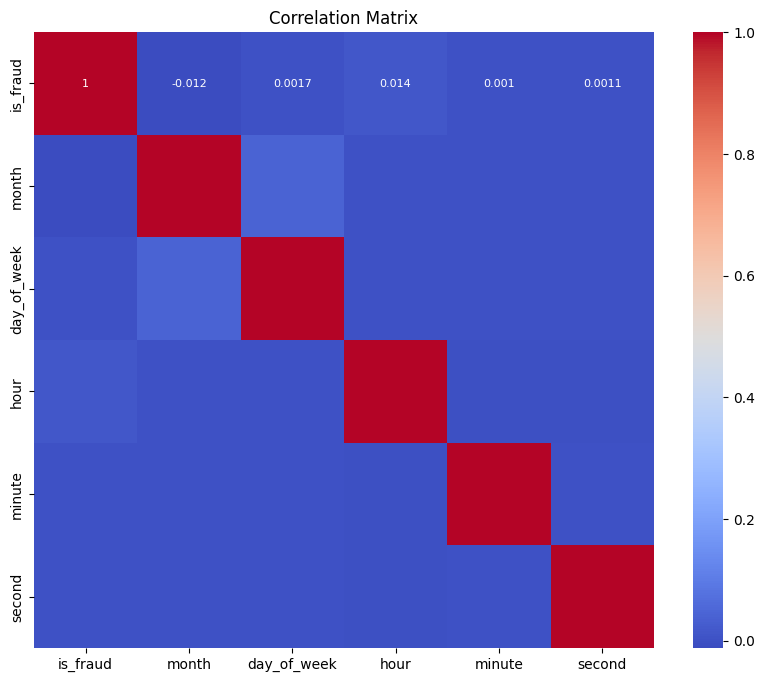

In [20]:
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt

correlation_matrix = time_df.select_dtypes(include='number').corr()
plt.figure(figsize=(10, 8))
plt.title('Correlation Matrix')
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, annot_kws={"size": 8})

### A személy-cc_num az egy-egy kapcsolat-e?

Pár ember van ugyan azzal a névvel de különböző date of birth-el.

De az alábbiak alapján látszik, hogy egy kártsa csak egy emberhez kapcsolódik.

In [21]:
df['person'] = df['first'] + ' ' + df['last'] + ' ' + df['dob']
df_multiple_cc  = df.groupby('person')['cc_num'].nunique()
df_multiple_cc[df_multiple_cc > 1]

Series([], Name: cc_num, dtype: int64)

In [22]:
df_multiple_cc  =df[['person','cc_num']].drop_duplicates().groupby('person')['cc_num'].count()
df_multiple_cc[df_multiple_cc > 1]

Series([], Name: cc_num, dtype: int64)

In [23]:
df['person'] = df['first'] + ' ' + df['last']
df_multiple_cc  = df.groupby('cc_num')['person'].nunique()
df_multiple_cc[df_multiple_cc > 1]

Series([], Name: person, dtype: int64)

### Mikor válnak fraud-á a tranzakciók?
Nem találtunk olyan mintázatot, ami alapján meg lehetne mondani, hogy mikor kezd el egy kártya csalásokat elkövetni. Van, hogy csak egy csalás van, van, hogy több is.

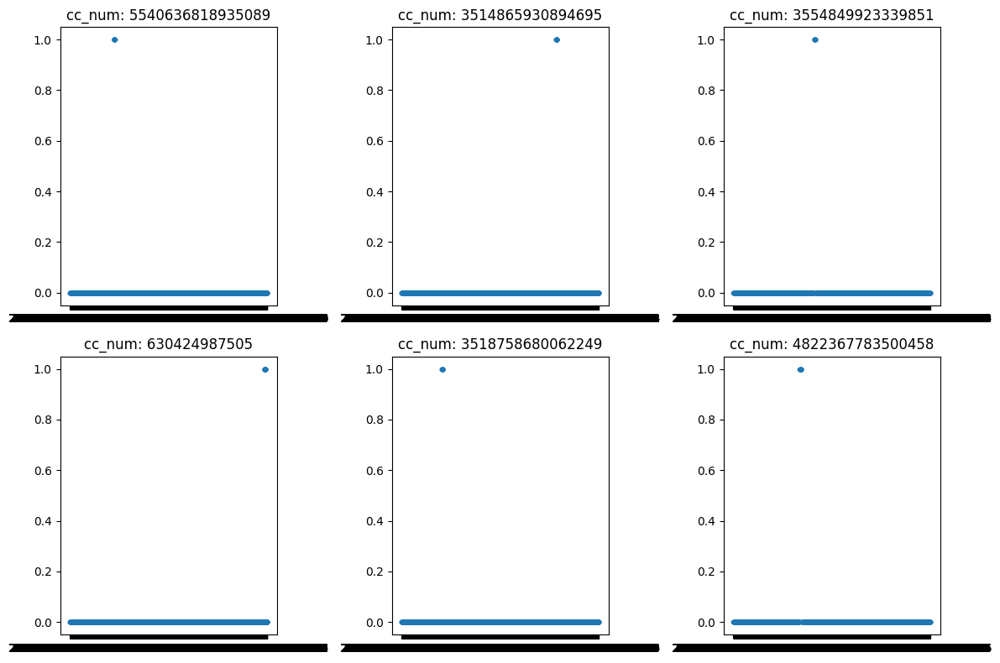

In [24]:
import random
import matplotlib.pyplot as plt

# 6 random fraud_cc_num
random_cc_nums = random.sample(df[df['is_fraud'] == 1]['cc_num'].unique().tolist(), 6)

fig, axes = plt.subplots(2, 3, figsize=(12, 8))
for i, cc_num in enumerate(random_cc_nums):
    row = i // 3
    col = i % 3
    df2 = df[df['cc_num'] == cc_num].sort_values(by='unix_time')
    axes[row, col].scatter(df2['trans_date_trans_time'], df2['is_fraud'], s=10)
    axes[row, col].set_title(f"cc_num: {cc_num}")

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()
